In [1]:
# requirements
# conda install -c conda-forge ffmpeg libsndfile
# pip install spleeter
# pip install pydub
# pip install yt_dlp
# pip install matplotlib
# pip install joblib

In [2]:
import yt_dlp
import pydub
import numpy as np
import os

import IPython.display as ipd
from IPython.display import Audio, display
from IPython.display import HTML

from matplotlib import pyplot as plt

import warnings
import joblib

from spleeter.separator import Separator
from spleeter.audio.adapter import AudioAdapter

import scipy.io.wavfile as wf

2024-04-21 17:02:14.442527: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-04-21 17:02:14.445952: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2024-04-21 17:02:14.445964: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [3]:
# Config definitions

filename = 'rent.mp3'

#url = "https://www.youtube.com/watch?v=qhvGDY7yCiU"
url = "https://www.youtube.com/watch?v=BAPzANPgxis&list=PLU43A23AIcgP1_GlWai5YwjF1TF6H_6jL&index=4"

output_folder = 'output/'+filename[:-4]+'/'

ydl_args = {
  'format':'bestaudio/best',
  'outtmpl':output_folder+filename,
  'playlist_items': '4'
}

sample_rate = 44100
separator_config = 'spleeter:4stems-16kHz'


In [4]:
# Download mp3 file from youtube link

if not os.path.exists(output_folder):
   os.makedirs(output_folder)

if not os.path.isfile(output_folder+filename):
    ydl = yt_dlp.YoutubeDL(ydl_args)
    ydl.download([url])
    print("mp3 file downloaded succesfully\n")
else:
    print("mp3 file already exists\n")
    

print(filename)
display(Audio(output_folder+filename, autoplay=False))

mp3 file already exists

rent.mp3


In [5]:
# Using embedded configuration.
separator = Separator(separator_config)
    
# Use audio loader explicitly for loading audio waveform :
audio_loader = AudioAdapter.default()
waveform, _ = audio_loader.load(output_folder+filename, sample_rate=sample_rate)

# Perform the separation :
prediction = separator.separate(waveform)

INFO:tensorflow:Using config: {'_model_dir': 'pretrained_models/4stems', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': gpu_options {
  per_process_gpu_memory_fraction: 0.7
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_experimental_max_worker_delay_secs': None, '_session_creation_timeout_secs': 7200, '_checkpoint_save_graph_def': True, '_service': None, '_cluster_spec': ClusterSpec({}), '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
Instructions for updating:
Use output_signature instead
Instructions for updating:
Use output_signature instead
INFO:tensorflow:Calling model_fn.
INFO:tensorflo

2024-04-21 17:02:28.343406: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2024-04-21 17:02:28.343624: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2024-04-21 17:02:28.344673: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublas.so.11'; dlerror: libcublas.so.11: cannot open shared object file: No such file or directory
2024-04-21 17:02:28.344703: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublasLt.so.11'; dlerror: libcublasLt.so.11: cannot open shared object file: No such file or directory
2024-04-21 17:02:28.344754: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Co

INFO:tensorflow:Apply unet for drums_spectrogram
INFO:tensorflow:Apply unet for bass_spectrogram
INFO:tensorflow:Apply unet for other_spectrogram
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from pretrained_models/4stems/model


2024-04-21 17:02:30.425120: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-04-21 17:02:30.425863: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2024-04-21 17:02:30.426026: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1850] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...
2024-04-21 17:02:30.610565: I tenso

INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


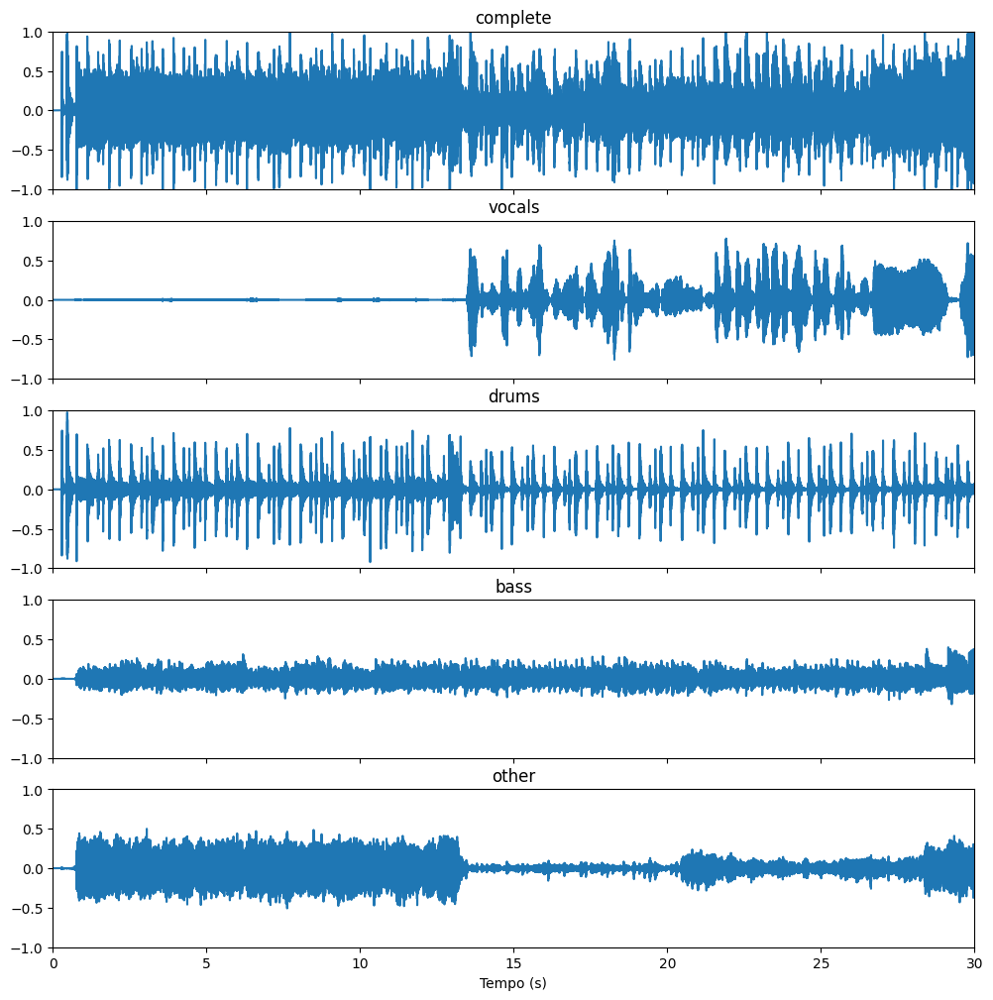

In [6]:
# Ploting wave forms

n_samples = len(waveform)
duration = n_samples/sample_rate
time = np.linspace(0, duration, num=n_samples)
time_init = 0
time_end = 30

fig, ax = plt.subplots(5,1, figsize=(12,12), sharex=True)

i = 0
ax[i].plot(time, waveform[:,0])
ax[i].set_title('complete')
ax[i].set_ylim([-1,1])
ax[i].set_xlim([time_init,time_end])

for split in prediction.keys():
    i = i + 1
    ax[i].plot(time, prediction[split][:,0])
    ax[i].set_title(split)
    ax[i].set_ylim([-1,1])
    ax[i].set_xlim([time_init,time_end])

ax[i].set_xlabel('Tempo (s)')
plt.show()

In [7]:
# Displaying waveforms

output_path = 'output/'+filename[:-4]+'/'

if not os.path.exists(output_path):
   os.makedirs(output_path)
    
for split in prediction.keys():
    save_path_wav = output_path+filename[:-4]+'_'+split+'.wav'
    save_path_mp3 = output_path+filename[:-4]+'_'+split+'.mp3'
    # saving wav
    wf.write(save_path_wav, sample_rate, prediction[split])

    # converting to mp3
    pydub.AudioSegment.from_wav(
        save_path_wav).export((
        save_path_mp3 ), format="mp3")

    # removing wav file
    os.remove(save_path_wav)

    # Convertendo 
    print(split)
    display(Audio(save_path_mp3, autoplay=False))


vocals


drums


bass


other


In [8]:
# Creating drumless file
combined_no_drums = prediction['vocals']+prediction['bass'] + prediction['other']

# Saving to wav
wf.write(output_path+filename[:-4]+'_drumless.wav', sample_rate, combined_no_drums)

# Converting to mp3
pydub.AudioSegment.from_wav(
    output_path+filename[:-4]+'_drumless.wav').export(
    (output_path+filename[:-4]+'_drumless.mp3'), format="mp3")

# Removing wav file
os.remove(output_path+filename[:-4]+'_drumless.wav')

print('drumless')
display(Audio(output_path+filename[:-4]+'_drumless.mp3'))

drumless
